<a href="https://colab.research.google.com/github/Alisson-S-Ribeiro/ProjetoCNN_T3/blob/main/ProjetoRes_def.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Carregando e visualizando o Banco de Dados

In [ ]:
import os
import math
import json
import time
import itertools
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from PIL import Image
from pickle import encode_long
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score, classification_report, roc_curve, auc, confusion_matrix
from tensorflow.keras.models import Sequential
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import BatchNormalization, LeakyReLU
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout



!pip install kaggle
!kaggle datasets download -d arbazkhan971/cuhk-face-sketch-database-cufs --force
!unzip -oq "cuhk-face-sketch-database-cufs.zip"

def list_files_in_folder(folder_path):
  """Lists all files in a given folder."""
  try:
    file_list = os.listdir(folder_path)
    return file_list
  except FileNotFoundError:
    print(f"Error: Folder not found at {folder_path}")
    return []

photos_folder = "photos"
files_in_photos = list_files_in_folder(photos_folder)

Dataset URL: https://www.kaggle.com/datasets/arbazkhan971/cuhk-face-sketch-database-cufs
License(s): copyright-authors
 95% 108M/113M [00:01<00:00, 62.0MB/s]
100% 113M/113M [00:01<00:00, 73.8MB/s]


In [ ]:
print(files_in_photos)
print(len(files_in_photos))
print (photos_folder)

['f-020-01.jpg', 'f-016-01.jpg', 'm1-021-01.jpg', 'm-021-01.jpg', 'm-009-01.jpg', 'm-045-01.jpg', 'm-074-01.jpg', 'm-076-01.jpg', 'f1-011-01.jpg', 'm1-022-01.jpg', 'f1-009-01.jpg', 'f-017-01.jpg', 'm-055-01.jpg', 'm-031-01.jpg', 'm-093-01.jpg', 'm-037-01.jpg', 'f-007-01.jpg', 'm-094-01.jpg', 'm1-011-01.jpg', 'f1-013-01.jpg', 'm-044-01.jpg', 'f-015-01.jpg', 'm-081-01.jpg', 'f-022-01.jpg', 'm-090-01.jpg', 'm1-014-01.jpg', 'f-032-01.jpg', 'm-030-01.jpg', 'm1-002-01.jpg', 'm-026-01.jpg', 'f1-014-01.jpg', 'f-012-01.jpg', 'f-010-01.jpg', 'm-028-01.jpg', 'm-010-01.jpg', 'f1-008-01.jpg', 'm-100-01.jpg', 'm-099-01.jpg', 'f-034-01.jpg', 'm1-007-01.jpg', 'm-068-01.jpg', 'm-018-01.jpg', 'm1-005-01.jpg', 'm1-027-01.jpg', 'm1-018-01.jpg', 'm1-033-01.jpg', 'm-082-01.jpg', 'm-096-01.jpg', 'm1-031-01.jpg', 'm-058-01.jpg', 'f-027-01.jpg', 'm1-006-01.jpg', 'm-095-01.jpg', 'f-026-01.jpg', 'f-037-01.jpg', 'm-069-01.jpg', 'm-091-01.jpg', 'm-036-01.jpg', 'm-089-01.jpg', 'm1-034-01.jpg', 'f-011-01.jpg', 'm1-0

Criando um arquivo Json para armazenar os resultados.

#Carregando as Imagens

Aqui, criamos uma função para buscarmos os arquivos de imagens na pasta especificada e retornamos uma lista com os caminhos completos para as imagens encontradas.

In [ ]:
def carregar_imagens(caminho_pasta):

    arquivos = [os.path.join(caminho_pasta, f) for f in os.listdir(caminho_pasta) if f.endswith(('.jpg'))]
    print(f"Imagens encontradas: {len(arquivos)}")
    return arquivos

caminho_pasta = "photos"
caminhos_imagens = carregar_imagens(caminho_pasta)


Imagens encontradas: 188


##Processar Imagens

Neste ponto, criamos outras duas funções, uma para redimensionar as imagens para 250x200 pixels usando (preprocessar_imagem). Isso garante que todas tenham dimensões uniformes, essencial para entrada em modelos de aprendizado de máquina. Além disso, dividimos todos os valores por 255 para normalizar para o intervalo entre [0, 1], o que ajuda no treinamento do modelo, já que valores normalizados aceleram o processo de convergência. Com a outra função, processamos todas as imagens fornecidas e as retornamos em um array NumPy.

In [ ]:
def preprocessar_imagem(imagem, tamanho_desejado=(200, 250)):

    imagem = imagem.resize(tamanho_desejado)
    imagem = np.array(imagem) / 255.0
    return np.array(imagem)

def processar_imagens(caminhos_imagens):

    imagens_processadas = [preprocessar_imagem(Image.open(caminho)) for caminho in caminhos_imagens]
    return np.array(imagens_processadas)
    imagens_processadas = [preprocessar_imagem(Image.open(caminho)) for caminho in caminhos_imagens]
    return np.array(imagens_processadas)

imagens_processadas = processar_imagens(caminhos_imagens)
print(f"Imagens processadas: {imagens_processadas.shape}")

Imagens processadas: (188, 250, 200, 3)


##Rotulando as imagens

Aqui, criamos uma função para rotular as imagens com base na primeira letra do nome do arquivo. Se o nome do arquivo começar com 'm', o rótulo será 1 (Masculino). Caso contrário, será 0 (Feminino). Desta forma, conseguiremos observar se há ou não uma relação entre a primeira letra do nome do caminho do arquivo e o sexo biologico visualmente identificavel na imagem.

In [ ]:
def rotular_imagem(nome_arquivo):

    return 1 if nome_arquivo.lower().startswith('m') else 0

def gerar_rotulos(caminhos_imagens):

    return [rotular_imagem(os.path.basename(caminho)) for caminho in caminhos_imagens]

rotulos = gerar_rotulos(caminhos_imagens)
print(f"Rótulos gerados: {rotulos}")
print(f"Total de rótulos gerados: {len(rotulos)}")


Rótulos gerados: [0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0]
Total de rótulos gerados: 188


#Validando rótulos

Neste ponto, criamos uma função para exibir as imagens rótuladas uma a uma, para garantir que os rótulos por inicial de arquivo foram criados de maneira acertiva.

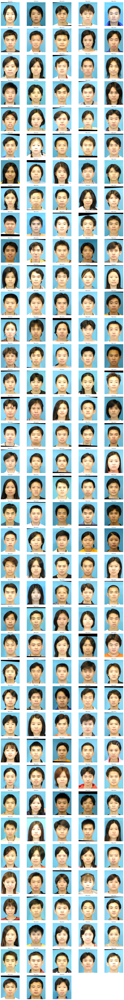

Total de Imagens: 188


In [ ]:
def exibir_imagens(imagens, rotulos):

    quantidade = len(imagens)
    colunas = 5
    linhas = math.ceil(quantidade / colunas)

    plt.figure(figsize=(15, linhas * 3))
    for i in range(quantidade):
        plt.subplot(linhas, colunas, i + 1)
        plt.imshow(imagens[i])
        plt.title(f"{'Masculino' if rotulos[i] == 1 else 'Feminino'}", fontsize=8)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

exibir_imagens(imagens_processadas, rotulos)
print(f"Total de Imagens: {len(imagens_processadas)}")

##Dividindo o Dataset

Após validarmos as rotulações, criamos uma função para dividir o dataset entre Teste, Validação e Treino, separando respectivamente 50% do banco para treino, 30% para validação e 20% para teste, conforme estipulado no documento do projeto. Essa proporção é adequada, pois garante uma maior robustez no trienamento e na validação do modelo, reduzindo as chances de underfitting.

In [ ]:
def dividir_dataset(imagens, rotulos, proporcoes=(0.5, 0.3, 0.2), seed=23):

    np.random.seed(seed)
    indices = np.arange(len(imagens))
    np.random.shuffle(indices)

    treino_fim = int(proporcoes[0] * len(indices))
    valid_fim = treino_fim + int(proporcoes[1] * len(indices))

    indices_treino = indices[:treino_fim]
    indices_valid = indices[treino_fim:valid_fim]
    indices_teste = indices[valid_fim:]

    return (
        (imagens[indices_treino], rotulos[indices_treino]),
        (imagens[indices_valid], rotulos[indices_valid]),
        (imagens[indices_teste], rotulos[indices_teste])
    )

(treino, validacao, teste) = dividir_dataset(imagens_processadas, np.array(rotulos))
print(f"Conjunto de Treino: {len(treino[0])} imagens")
print(f"Conjunto de Validação: {len(validacao[0])} imagens")
print(f"Conjunto de Teste: {len(teste[0])} imagens")


Conjunto de Treino: 94 imagens
Conjunto de Validação: 56 imagens
Conjunto de Teste: 38 imagens


Preparar os dados de Treinamento

In [ ]:
X_treino, y_treino = treino
X_validacao, y_validacao = validacao
X_teste, y_teste = teste

print(f"Conjunto de Treino: {len(X_treino)})")
print(f"Conjunto de Validação: {len(X_validacao)})")
print(f"Conjunto de Teste: {len(X_teste)})")

Conjunto de Treino: 94)
Conjunto de Validação: 56)
Conjunto de Teste: 38)


##Criando o Modelo de Rede Neural Convolucional (CNN)

Aqui, criaremos o modelo de CNN. Primeiro, estabelecemos qual o tamanho das imagens de entrada que o modelo irá aceitar, neste cawso, será o que definimos anteriormente com base na sugestão do documento. Neste caso, utilizaremos o modelo Sequential do Keras, rodando através do Tensorflow. Este modelo é o mais adequado quando temos uma pilha de camadas simples, com apenas um tensor de entrada e um de saída. Primeiramente, usaremos 3 camadas convolucionais com função de ativação ReLu, com filtros de tamanhos variados e em cada camada convolucional, teremos uma camada max Pooling para reduzir a dimensionalidade. Para evitar o overfitting, introduzimos uma camada dropout para regularização, após algumas camadas. Finalizamos com camadas densas para mapear as extrações de características aos rótulos binários e uma camada com ativação sigmoid para prever uma única probabilidade de classe, que será a nossa saída.

In [ ]:
def modelo_cnn(input_shape=(200, 250, 3)):

  modelo = Sequential()

  modelo.add(Conv2D(32, (3, 3), activation='relu', input_shape=input_shape))
  modelo.add(MaxPooling2D((2, 2)))

  modelo.add(Conv2D(64, (3, 3), activation='relu'))
  modelo.add(MaxPooling2D((2, 2)))

  modelo.add(Conv2D(128, (3, 3), activation='relu'))
  modelo.add(MaxPooling2D((2, 2)))

  modelo.add(Conv2D(256, 3, 3, activation='relu'))
  modelo.add(MaxPooling2D((2, 2)))

  modelo.add(Flatten())

  modelo.add(Dense(128, activation='relu'))
  modelo.add(Dropout(0.5))
  modelo.add(Dense(64, activation='relu'))
  modelo.add(Dense(1, activation='sigmoid'))

  modelo.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

  return modelo

modelo = modelo_cnn()
modelo.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 198, 248, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 99, 124, 32)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 97, 122, 64)         │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 48, 61, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 46, 59, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 23, 29, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 7, 9, 256)           │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 3, 4, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 3072)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │         393,344 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 790,081 (3.01 MB)

 Trainable params: 790,081 (3.01 MB)

 Non-trainable params: 0 (0.00 B)

##Treinamento do Modelo (Hiperparametros Multiplos)

Estabelecendo a lista de hiperparametros multiplos a serem testados e criando um modelo a cada teste executado, para futuramente podermos avaliar as metricas de cada um e estabelcer qual é o melhor numero de hiperparametros a ser utilizado.

In [ ]:
epochs = [10, 15, 20]
batch_sizes = [32, 64, 128]

# Verifica se o arquivo JSON já existe e carrega os dados
if os.path.exists('resultados.json'):
    with open('resultados.json', 'r') as file:
        results = json.load(file)
else:
    results = []  # Inicia com uma lista vazia, se o arquivo não existir


# Loop sobre combinações de hiperparâmetros
for epoch, batch_size in itertools.product(epochs, batch_sizes):
    model_name = f"modelo_{epoch}ep_{batch_size}bs"
    print(f"\nTreinando {model_name}...")
    model = modelo_cnn()
    start_time = time.time()
    historico = model.fit(
      X_treino, y_treino,
      epochs=epoch,
      batch_size=batch_size,
      validation_data = (X_validacao, y_validacao),
      verbose=1
  )
    end_time = time.time()

    test_loss, test_accuracy = model.evaluate(X_teste, y_teste, verbose=0)
    print(f"Perda: {test_loss}")
    print(f"Acurácia: {test_accuracy}")

    results.append({
        "model_name": model_name,
        "epochs": epochs,
        "batch_size": batch_size,
        "train_loss": float(historico.history['loss'][-1]),
        "val_loss": float(historico.history['val_loss'][-1]),
        "test_loss": float(test_loss),
        "test_accuracy": float(test_accuracy),
        "training_time": end_time - start_time
    })

# Salva todos os resultados incrementais
    with open('resultados.json', 'w') as file:
        json.dump(results, file, indent=4)

    print(f"Modelo {model_name} salvo com sucesso!")

    print("\nTodos os modelos foram processados e salvos.")


Treinando modelo_5ep_16bs...
Epoch 1/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step - accuracy: 0.7407 - loss: 0.6190 - val_accuracy: 0.6964 - val_loss: 0.6377
Epoch 2/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 12s 2s/step - accuracy: 0.7609 - loss: 0.5948 - val_accuracy: 0.6964 - val_loss: 0.6149
Epoch 3/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step - accuracy: 0.7177 - loss: 0.5816 - val_accuracy: 0.6964 - val_loss: 0.6109
Epoch 4/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 13s 2s/step - accuracy: 0.7105 - loss: 0.6039 - val_accuracy: 0.6964 - val_loss: 0.6144
Epoch 5/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 21s 2s/step - accuracy: 0.7262 - loss: 0.6149 - val_accuracy: 0.6964 - val_loss: 0.5933
Perda: 0.6167159080505371
Acurácia: 0.6842105388641357
Modelo modelo_5ep_16bs salvo com sucesso!

Todos os modelos foram processados e salvos.

Treinando modelo_5ep_32bs...
Epoch 1/5
3/3 ━━━━━━━━━━━━━━━━━━━━ 15s 4s/step - accuracy: 0.4403 - loss: 0.6927 - val_accuracy: 0.6964 - val_loss: 0.6111
Epoch 2/5
3/3 ━━━━━━━━━━━━━━━━━━━━ 21s 5s/step - accuracy: 

Visualização Gráfica do desempenho dos modelos

In [ ]:
if os.path.exists('resultados.json'):
    with open('resultados.json', 'r') as file:
        results = json.load(file)

print("Resultados:\n")
for result in results:
  print(f"Modelo: {result['model_name']}")
  print(f"Épocas: {result['epochs']}")
  print(f"Perda de Treino: {result['train_loss']}")
  print(f"Perda de Validação: {result['val_loss']}")
  print(f"Perda de Teste: {result['test_loss']}")
  print(f"Acurácia de Teste: {result['test_accuracy']}")
  print(f"Tempo de Treinamento: {result['training_time']:.2f} segundos\n")
  print("-" * 30)


Resultados:

Modelo: modelo_5ep_16bs
Épocas: [5, 10, 15]
Perda de Treino: 0.5813116431236267
Perda de Validação: 0.5932841300964355
Perda de Teste: 0.6167159080505371
Acurácia de Teste: 0.6842105388641357
Tempo de Treinamento: 83.89 segundos

------------------------------
Modelo: modelo_5ep_32bs
Épocas: [5, 10, 15]
Perda de Treino: 0.5836207866668701
Perda de Validação: 0.6038689017295837
Perda de Teste: 0.6150768399238586
Acurácia de Teste: 0.6842105388641357
Tempo de Treinamento: 105.26 segundos

------------------------------
Modelo: modelo_5ep_64bs
Épocas: [5, 10, 15]
Perda de Treino: 0.6041058897972107
Perda de Validação: 0.6068655252456665
Perda de Teste: 0.6167240142822266
Acurácia de Teste: 0.6842105388641357
Tempo de Treinamento: 84.94 segundos

------------------------------
Modelo: modelo_10ep_16bs
Épocas: [5, 10, 15]
Perda de Treino: 0.32428041100502014
Perda de Validação: 0.42379602789878845
Perda de Teste: 0.6243804693222046
Acurácia de Teste: 0.8157894611358643
Tempo de

Visualizando graficamente o desempenho de cada um dos modelos.

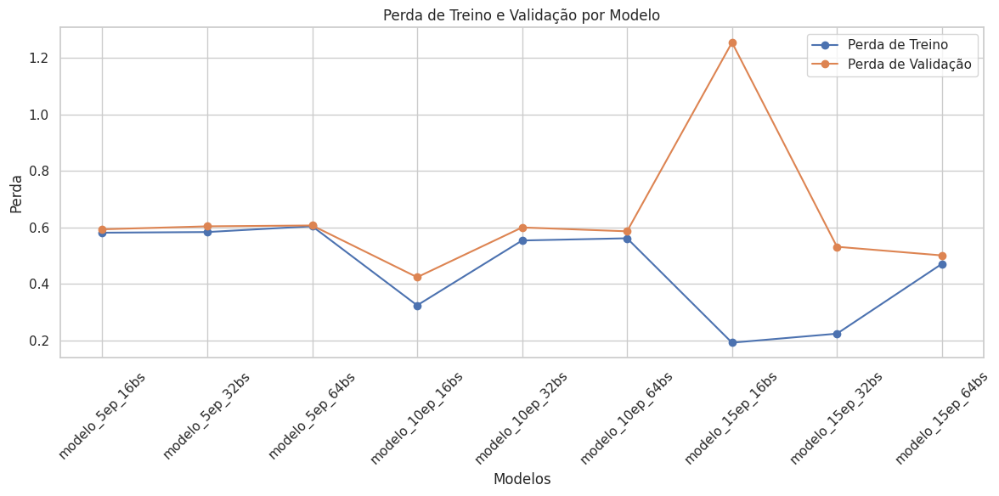

<ipython-input-12-94622c321057>:28: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=model_names, y=test_accuracies, palette='viridis')


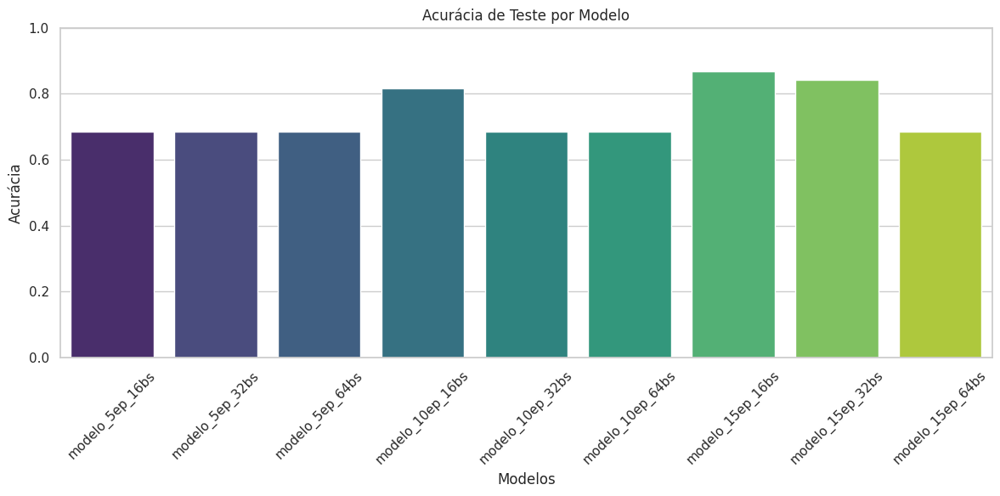

<ipython-input-12-94622c321057>:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=model_names, y=training_times, palette='coolwarm')


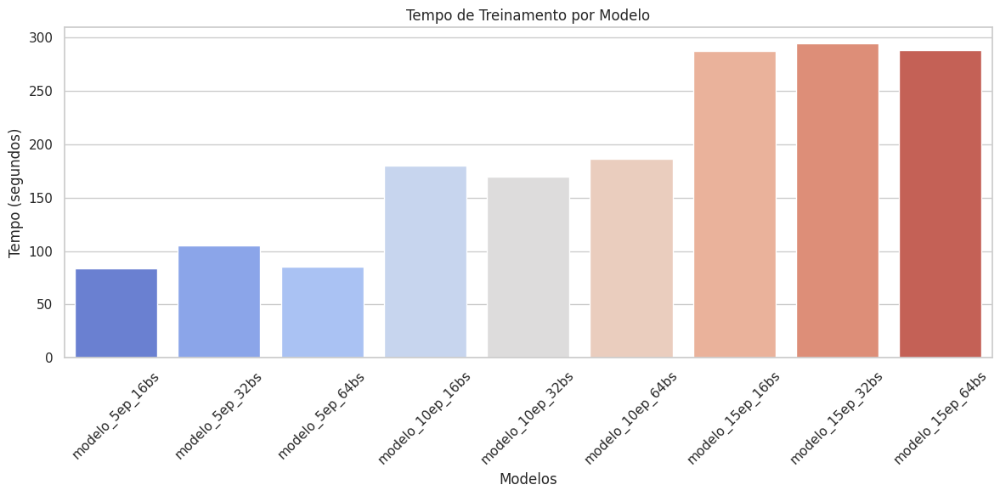

In [ ]:
with open('resultados.json', 'r') as file:
    results = json.load(file)

# Converte resultados em listas para gráficos
model_names = [result["model_name"] for result in results]
train_losses = [result["train_loss"] for result in results]
val_losses = [result["val_loss"] for result in results]
test_accuracies = [result["test_accuracy"] for result in results]
training_times = [result["training_time"] for result in results]

# Configurações do estilo
sns.set(style="whitegrid")

# 1. Gráfico de Perda de Treino e Validação
plt.figure(figsize=(12, 6))
plt.plot(model_names, train_losses, label='Perda de Treino', marker='o')
plt.plot(model_names, val_losses, label='Perda de Validação', marker='o')
plt.xticks(rotation=45)
plt.title('Perda de Treino e Validação por Modelo')
plt.xlabel('Modelos')
plt.ylabel('Perda')
plt.legend()
plt.tight_layout()
plt.show()

# 2. Gráfico de Acurácia no Teste
plt.figure(figsize=(12, 6))
sns.barplot(x=model_names, y=test_accuracies, palette='viridis')
plt.xticks(rotation=45)
plt.title('Acurácia de Teste por Modelo')
plt.xlabel('Modelos')
plt.ylabel('Acurácia')
plt.ylim(0, 1)  # Limita de 0 a 1 para acurácia
plt.tight_layout()
plt.show()

# 3. Gráfico de Tempo de Treinamento
plt.figure(figsize=(12, 6))
sns.barplot(x=model_names, y=training_times, palette='coolwarm')
plt.xticks(rotation=45)
plt.title('Tempo de Treinamento por Modelo')
plt.xlabel('Modelos')
plt.ylabel('Tempo (segundos)')
plt.tight_layout()
plt.show()


##Treinamento da Rede Neural (Hiperparametros unicos)

Aqui, treinamos o modelo com hiperparametros unicos, utilizando 10 epócas e 32 ba

In [ ]:
loss, accuracy = modelo.evaluate(X_teste, y_teste)
print(f"Loss: {loss}")
print(f"Accuracy: {accuracy}")

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 151ms/step - accuracy: 0.6749 - loss: 0.6906
Loss: 0.69049072265625
Accuracy: 0.6842105388641357


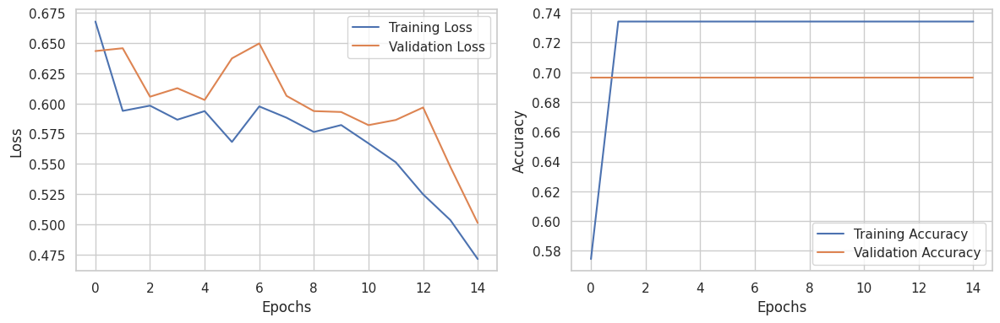

In [ ]:
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(historico.history['loss'], label='Training Loss')
plt.plot(historico.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(historico.history['accuracy'], label='Training Accuracy')
plt.plot(historico.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()


In [ ]:
y_pred_probs = modelo.predict(teste[0])  # Obtém as probabilidades preditas
y_pred = (y_pred_probs > 0.5).astype(int).flatten()  # Converte probabilidades em rótulos (0 ou 1)


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 255ms/step


In [ ]:
f1 = f1_score(teste[1], y_pred)
print(f"F1-Score: {f1:.2f}")
print("\nRelatório de Classificação:")
print(classification_report(teste[1], y_pred))


F1-Score: 0.81

Relatório de Classificação:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        12
           1       0.68      1.00      0.81        26

    accuracy                           0.68        38
   macro avg       0.34      0.50      0.41        38
weighted avg       0.47      0.68      0.56        38



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


fpr, tpr, thresholds = roc_curve(teste[1], y_pred_probs)
roc_auc = auc(fpr, tpr)

##Treinando um segundo modelo

In [ ]:
from tensorflow.keras.layers import BatchNormalization, LeakyReLU

def modelo_cnn_aprimorado(input_shape=(200, 250, 3)):

    modelo2 = Sequential()  # Create the main model instance

    # Primeira camada convolucional
    modelo2.add(Conv2D(32, (3, 3), activation='relu', input_shape=input_shape)) # Add layers to the main model
    modelo2.add(MaxPooling2D((2, 2)))
    modelo2.add(BatchNormalization())

    # Segunda camada convolucional
    modelo2.add(Conv2D(64, (3, 3), activation='relu'))
    modelo2.add(MaxPooling2D((2, 2)))
    modelo2.add(BatchNormalization())

    # Terceira camada convolucional
    modelo2.add(Conv2D(128, (3, 3), activation='relu'))
    modelo2.add(MaxPooling2D((2, 2)))
    modelo2.add(BatchNormalization())

    # Camada adicional para maior profundidade
    modelo2.add(Conv2D(256, (3, 3), activation='relu'))
    modelo2.add(MaxPooling2D((2, 2)))
    modelo2.add(Dropout(0.4))  # Regularização adicional

    modelo2.add(Flatten())

    # Camadas densas com regularização
    modelo2.add(Dense(128))
    modelo2.add(LeakyReLU(alpha=0.1))  # Ativação alternativa
    modelo2.add(Dropout(0.5))
    modelo2.add(Dense(64, activation='relu'))
    modelo2.add(Dense(1, activation='sigmoid'))

    # Compilação com RMSprop
    modelo2.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy']) # Compile the main model

    return modelo2

modelo_aprimorado = modelo_cnn_aprimorado()
modelo_aprimorado.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.10/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_40 (Conv2D)                   │ (None, 198, 248, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_40 (MaxPooling2D)      │ (None, 99, 124, 32)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 99, 124, 32)         │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_41 (Conv2D)                   │ (None, 97, 122, 64)         │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_41 (MaxPooling2D)      │ (None, 48, 61, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 48, 61, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_42 (Conv2D)                   │ (None, 46, 59, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_42 (MaxPooling2D)      │ (None, 23, 29, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 23, 29, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_43 (Conv2D)                   │ (None, 21, 27, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_43 (MaxPooling2D)      │ (None, 10, 13, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_10 (Dropout)                 │ (None, 10, 13, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_10 (Flatten)                 │ (None, 33280)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_30 (Dense)                     │ (None, 128)                 │       4,259,968 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_11 (Dropout)                 │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_31 (Dense)                     │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_32 (Dense)                     │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 4,657,601 (17.77 MB)

 Trainable params: 4,657,153 (17.77 MB)

 Non-trainable params: 448 (1.75 KB)

Treinando modelo com 10 épocas e batch_size=16
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 148ms/step


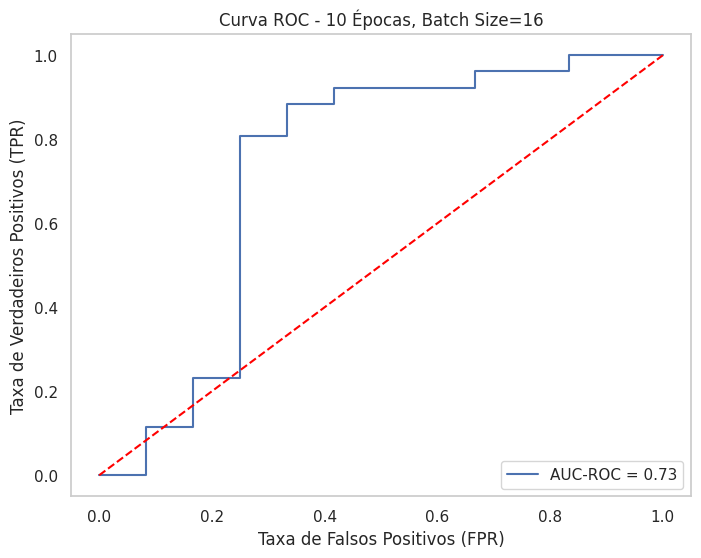

Treinando modelo com 10 épocas e batch_size=32


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.10/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 146ms/step


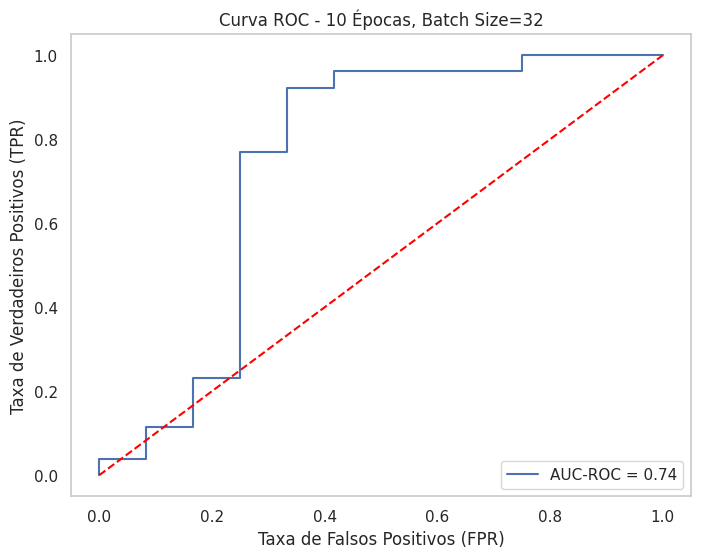

Treinando modelo com 10 épocas e batch_size=64


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.10/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 176ms/step


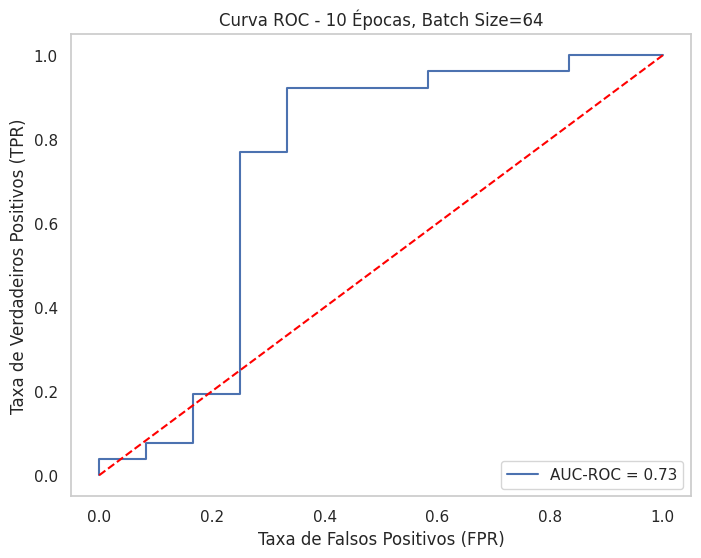

Treinando modelo com 15 épocas e batch_size=16


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.10/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


In [ ]:
results2 = []  # Lista para armazenar os resultados

# Hiperparâmetros para experimentos
epocas_lista = [10, 15, 20]
batch_sizes_lista = [16, 32, 64]

# Loop sobre combinações de épocas e batch_sizes
for epocas in epocas_lista:
    for batch_size in batch_sizes_lista:
        print(f"Treinando modelo com {epocas} épocas e batch_size={batch_size}")

        # Instanciando modelo
        modelo2 = modelo_cnn_aprimorado()

        # Configurando Early Stopping
        early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

        # Treinamento do modelo
        inicio = time.time()
        historico2 = modelo.fit(
            treino[0], treino[1],
            epochs=epocas,
            batch_size=batch_size,
            validation_data=(validacao[0], validacao[1]),
            callbacks=[early_stopping],
            verbose=0
        )
        tempo_total = time.time() - inicio

        # Avaliação no conjunto de teste
        y_pred_probs = modelo.predict(teste[0])
        y_pred = (y_pred_probs > 0.5).astype(int).flatten()

        # Cálculo das métricas
        f1 = f1_score(teste[1], y_pred)
        fpr, tpr, thresholds = roc_curve(teste[1], y_pred_probs)
        auc_roc = auc(fpr, tpr)

        # Armazenando os resultados na lista
        results2.append({
            'Épocas': epocas,
            'Batch Size': batch_size,
            'F1-Score': f1,
            'AUC-ROC': auc_roc,
            'Tempo de Treinamento': tempo_total
        })

        # Gráfico da Curva ROC para cada modelo
        plt.figure(figsize=(8, 6))
        plt.plot(fpr, tpr, label=f'AUC-ROC = {auc_roc:.2f}')
        plt.plot([0, 1], [0, 1], color='red', linestyle='--')
        plt.xlabel('Taxa de Falsos Positivos (FPR)')
        plt.ylabel('Taxa de Verdadeiros Positivos (TPR)')
        plt.title(f'Curva ROC - {epocas} Épocas, Batch Size={batch_size}')
        plt.legend(loc="lower right")
        plt.grid()
        plt.show()

# Exibindo resultados
for i, res in enumerate(results):
    print(f"Modelo {i+1}: {res}")
